- Labels in this dataset:
    - :0 helmetP
    1:-  et
    - 2: no helm]t



- More info:
    - Number of classes: 3
    - Label Annotation: YOLO format (.txt)
      - `[class_id, center_x, center_y, width, height]`
      
___      

Yolo Dataset folder structure: the paths to these folders will be written to a YAML file that will be used by Yolo.

```
Custom dataset directory (root)
    - train
        - images (folder including all training images)
        - labels (folder including all training labels)
    - validation
        - images (folder including all validation images)
        - labels (folder including all validation labels)
    - test
        - images (folder including all test images)
        - labels (folder including all test labels)

```

In [3]:
! nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-a727dfe4-a94f-34cf-e4fb-1a0c7911de87)
GPU 1: Tesla T4 (UUID: GPU-a0b1a5dc-4fda-5d78-c8d1-6c3de11a9488)


# Installs/Imports

In [4]:
! pip install --upgrade ultralytics -qq


In [5]:
import ultralytics
print(ultralytics.__version__)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
8.3.40


In [6]:
import warnings
warnings.filterwarnings("ignore")

import os
import re
import glob
import random
import yaml

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import seaborn as sns
import torch

import IPython.display as display
from PIL import Image
import cv2

from ultralytics import YOLO

In [7]:
! wandb disabled

W&B disabled.


# CFG

- CFG class enables easy and organized experimentation
- Set `DEBUG = True` to make quick experiments

In [8]:
class CFG:
    SEED = 1
    # classes
    NUM_CLASSES = 3
    CLASSES = ['helmet', 'LP', 'no helmet']

    # training
    EPOCHS = 200 
    BATCH_SIZE = 32
    
    BASE_MODEL = 'yolov8n' # yolov8n, yolov8s, yolov8m, yolov8l, yolov8x, yolov9c, yolov9e
    BASE_MODEL_WEIGHTS = f'{BASE_MODEL}.pt'
    EXP_NAME = f'ppe_css_{EPOCHS}_epochs'
    
    OPTIMIZER = 'auto' # SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto
    LR = 0.001
    LR_FACTOR = 0.01
    WEIGHT_DECAY = 5e-4
    DROPOUT = 0.0
    PATIENCE = 20
    PROFILE = False
    LABEL_SMOOTHING = 0.0    

    # paths
    CUSTOM_DATASET_DIR = '/kaggle/input/helmet-detection-v3i'
    OUTPUT_DIR = '/kaggle/working/'

# Create YAML file

- Create ```data.yaml``` file properly formatted to be used by Yolo

In [9]:
dict_file = {
    'train': os.path.join(CFG.CUSTOM_DATASET_DIR, 'train'),
    'val': os.path.join(CFG.CUSTOM_DATASET_DIR, 'valid'),
    'test': os.path.join(CFG.CUSTOM_DATASET_DIR, 'test'),
    'nc': CFG.NUM_CLASSES,
    'names': CFG.CLASSES
    }

with open(os.path.join(CFG.OUTPUT_DIR, 'data.yaml'), 'w+') as file:
    yaml.dump(dict_file, file)

In [10]:
### read yaml file created
def read_yaml_file(file_path = CFG.CUSTOM_DATASET_DIR):
    with open(file_path, 'r') as file:
        try:
            data = yaml.safe_load(file)
            return data
        except yaml.YAMLError as e:
            print("Error reading YAML:", e)
            return None

### print it with newlines
def print_yaml_data(data):
    formatted_yaml = yaml.dump(data, default_style=False)
    print(formatted_yaml)

file_path = os.path.join(CFG.OUTPUT_DIR, 'data.yaml')
yaml_data = read_yaml_file(file_path)

if yaml_data:
    print_yaml_data(yaml_data)

names:
- helmet
- LP
- no helmet
nc: 3
test: /kaggle/input/helmet-detection-v3i/test
train: /kaggle/input/helmet-detection-v3i/train
val: /kaggle/input/helmet-detection-v3i/valid



# Dataset

- Check some images
- Image utils

## Visualize one image

Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (640, 640, 3) 



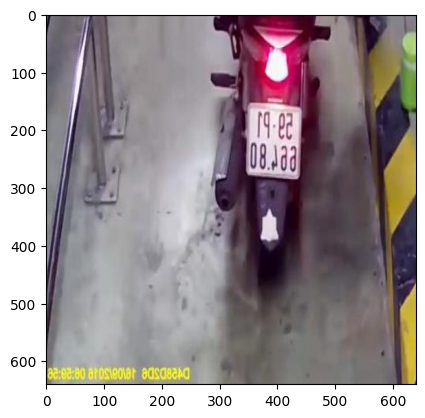

In [11]:
def display_image(image, print_info = True, hide_axis = False):
    if isinstance(image, str):  # Check if it's a file path
        img = Image.open(image)
        plt.imshow(img)
    elif isinstance(image, np.ndarray):  # Check if it's a NumPy array
        image = image[..., ::-1]  # BGR to RGB
        img = Image.fromarray(image)
        plt.imshow(img)
    else:
        raise ValueError("Unsupported image format")

    if print_info:
        print('Type: ', type(img), '\n')
        print('Shape: ', np.array(img).shape, '\n')

    if hide_axis:
        plt.axis('off')

    plt.show()
    
example_image_path = '/kaggle/input/helmet-detection-v3i/train/images/0000_00532_b_jpg.rf.167dacb99fb3d649ecb65ac8fecf5978.jpg'

display_image(example_image_path, print_info = True, hide_axis = False)

## Visualize many images

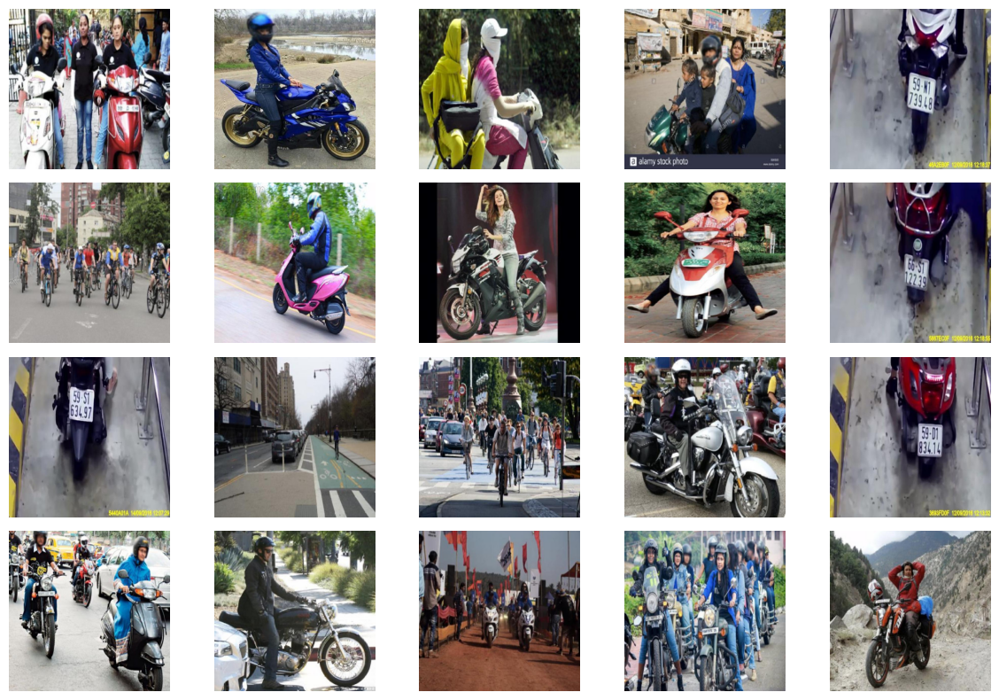

In [12]:
def plot_random_images_from_folder(folder_path, num_images=20, seed=CFG.SEED):

    # Get a list of image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg', '.gif'))]

    # Ensure that we have at least num_images files to choose from
    if len(image_files) < num_images:
        raise ValueError("Not enough images in the folder")

    # Randomly select num_images image files
    selected_files = random.sample(image_files, num_images)

    # Create a subplot grid
    num_cols = 5
    num_rows = (num_images + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 8))

    for i, file_name in enumerate(selected_files):
        # Open and display the image using PIL
        img = Image.open(os.path.join(folder_path, file_name))
        
        if num_rows == 1:
            ax = axes[i % num_cols]
        else:
            ax = axes[i // num_cols, i % num_cols]
        
        ax.imshow(img)
        ax.axis('off')
        # ax.set_title(file_name)

    # Remove empty subplots
    for i in range(num_images, num_rows * num_cols):
        if num_rows == 1:
            fig.delaxes(axes[i % num_cols])
        else:
            fig.delaxes(axes[i // num_cols, i % num_cols])

    plt.tight_layout()
    plt.show()
    
folder_path = CFG.CUSTOM_DATASET_DIR + '/train/images/'
plot_random_images_from_folder(folder_path, num_images=20, seed=CFG.SEED)

## Image properties

In [13]:
def get_image_properties(image_path):
    # Read the image file
    img = cv2.imread(image_path)

    # Check if the image file is read successfully
    if img is None:
        raise ValueError("Could not read image file")

    # Get image properties
    properties = {
        "width": img.shape[1],
        "height": img.shape[0],
        "channels": img.shape[2] if len(img.shape) == 3 else 1,
        "dtype": img.dtype,
    }

    return properties

img_properties = get_image_properties(example_image_path)
img_properties

{'width': 640, 'height': 640, 'channels': 3, 'dtype': dtype('uint8')}

## Dataset statistics

In [14]:
%%time
class_idx = {str(i): CFG.CLASSES[i] for i in range(CFG.NUM_CLASSES)}

class_stat = {}
data_len = {}
class_info = []

for mode in ['train', 'valid', 'test']:
    class_count = {CFG.CLASSES[i]: 0 for i in range(CFG.NUM_CLASSES)}

    path = os.path.join(CFG.CUSTOM_DATASET_DIR, mode, 'labels')

    for file in os.listdir(path):
        with open(os.path.join(path, file)) as f:
            lines = f.readlines()

            for cls in set([line[0] for line in lines]):
                class_count[class_idx[cls]] += 1

    data_len[mode] = len(os.listdir(path))
    class_stat[mode] = class_count

    class_info.append({'Mode': mode, **class_count, 'Data_Volume': data_len[mode]})

dataset_stats_df = pd.DataFrame(class_info)
dataset_stats_df

CPU times: user 112 ms, sys: 140 ms, total: 251 ms
Wall time: 5.48 s


,Mode,helmet,LP,no helmet,Data_Volume
0,train,847,521,525,1528
1,valid,97,56,52,161
2,test,40,20,37,80


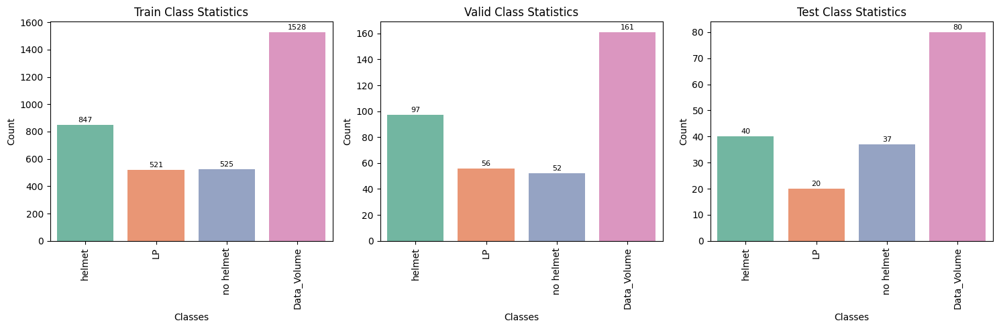

In [15]:
# Create subplots with 1 row and 3 columns
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot vertical bar plots for each mode in subplots
for i, mode in enumerate(['train', 'valid', 'test']):
    sns.barplot(
        data=dataset_stats_df[dataset_stats_df['Mode'] == mode].drop(columns='Mode'),
        orient='v',
        ax=axes[i],
        palette='Set2'
    )
    
    axes[i].set_title(f'{mode.capitalize()} Class Statistics')
    axes[i].set_xlabel('Classes')
    axes[i].set_ylabel('Count')
    axes[i].tick_params(axis='x', rotation=90) 

    # Add annotations on top of each bar
    for p in axes[i].patches:
        axes[i].annotate(f"{int(p.get_height())}", (p.get_x() + p.get_width() / 2., p.get_height()),
                         ha='center', va='center', fontsize=8, color='black', xytext=(0, 5),
                         textcoords='offset points')

plt.tight_layout()
plt.show()

## Image sizes

# Train

[Arguments for training](https://docs.ultralytics.com/modes/train/#arguments)

In [16]:
### Load pre-trained YOLO model
model = YOLO(CFG.BASE_MODEL_WEIGHTS)

100%|██████████| 6.25M/6.25M [00:00<00:00, 116MB/s]


In [ ]:
!pip install -U ipywidgets

In [19]:
# import torch
# torch.cuda.empty_cache()
# cuda_available = torch.cuda.is_available()
# print(cuda_available)


In [21]:
### train
results = model.train(
    data=os.path.join(CFG.OUTPUT_DIR, 'data.yaml'),
    epochs = CFG.EPOCHS,
    batch = CFG.BATCH_SIZE,
    optimizer = CFG.OPTIMIZER,
    lr0 = CFG.LR,
    lrf = CFG.LR_FACTOR,
    imgsz = (img_properties['height'], img_properties['width']),
    seed = CFG.SEED,
    device = [0,1], #[0,1], # 0
    workers=4,
    name='yolov8n_HelmetDetection')

Ultralytics 8.3.40 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/kaggle/working/yolov8n.pt, data=/kaggle/working/data.yaml, epochs=200, time=None, patience=100, batch=32, imgsz=(640, 640), save=True, save_period=-1, cache=False, device=[0, 1], workers=4, project=None, name=yolov8n_HelmetDetection, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=1, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False,

train: Scanning /kaggle/input/helmet-detection-v3i/train/labels... 1528 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1528/1528 [00:01<00:00, 914.73it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/helmet-detection-v3i/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/input/helmet-detection-v3i/valid/labels... 161 images, 0 backgrounds, 0 corrupt: 100%|██████████| 161/161 [00:00<00:00, 495.70it/s]/s]


val: WARNING ⚠️ Cache directory /kaggle/input/helmet-detection-v3i/valid is not writeable, cache not saved.


train: Scanning /kaggle/input/helmet-detection-v3i/train/labels... 1528 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1528/1528 [00:02<00:00, 670.15it/s]


Plotting labels to runs/detect/yolov8n_HelmetDetection/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/yolov8n_HelmetDetection
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/200      2.28G      1.343      3.035      1.231         64        640: 100%|██████████| 48/48 [00:24<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:07<00:00,  1.29s/it]


                   all        161        397          1     0.0458      0.557      0.365

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/200      2.17G      1.229      1.671      1.148         33        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.911      0.491      0.676       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/200      2.15G      1.173      1.464      1.109         41        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.746      0.614       0.68      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/200      2.17G      1.194      1.339      1.131         56        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.802      0.684      0.742       0.49

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/200       2.2G      1.111      1.234      1.106         58        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.774      0.744      0.784      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/200      2.17G       1.15      1.149      1.108         19        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.808      0.741      0.789      0.517

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/200      2.19G        1.1      1.037      1.084         39        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.787       0.67      0.727      0.488

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/200      2.19G      1.057     0.9911      1.084         34        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.795      0.754      0.793      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/200      2.19G      1.035     0.9539      1.069         41        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.742      0.733      0.749      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/200      2.17G      1.059      0.905      1.082         45        640: 100%|██████████| 48/48 [00:22<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.771      0.767      0.789      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/200      2.16G      1.029     0.8584      1.053         45        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.772      0.804       0.83      0.541


  0%|          | 0/48 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/200       2.2G      1.036     0.8236      1.061         23        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.738      0.779      0.784      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/200      2.17G     0.9986     0.7792      1.054         36        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.768      0.801      0.791      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/200      2.21G      1.036     0.7963      1.065         63        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.806      0.781      0.798       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/200      2.22G      1.023     0.7743      1.054         52        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.779      0.811      0.792      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/200      2.15G     0.9751      0.738      1.037         23        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.797      0.813      0.825      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/200       2.3G       1.01     0.7574      1.046         66        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.799      0.756      0.795      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/200      2.19G     0.9359     0.6816      1.026         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.779      0.798      0.802       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/200      2.19G     0.9248     0.6682      1.022         50        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.801      0.773      0.795      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/200       2.2G     0.9011     0.6461      1.006         34        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.826      0.764      0.814      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/200      2.17G     0.9137     0.6468      1.009         44        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.802       0.81      0.837       0.57

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/200      2.19G     0.9132     0.6535      1.027         24        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.832      0.771       0.81       0.55

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/200      2.17G     0.9196     0.6427      1.017         29        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.844      0.753      0.794       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/200      2.19G     0.9067     0.6369      1.014         39        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.811      0.814      0.838      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/200      2.29G     0.8741     0.5958     0.9945         56        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.85      0.791      0.846      0.571

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/200      2.19G     0.8658     0.6005     0.9909         24        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.833      0.808      0.842      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/200      2.17G     0.8712     0.5852     0.9972         32        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.779      0.836      0.557

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/200      2.16G     0.8586     0.5867     0.9852         58        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.855      0.794      0.842      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/200      2.19G     0.8574     0.5761     0.9864         39        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.843      0.761      0.802      0.551

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/200      2.17G     0.8287     0.5522     0.9769         44        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.865      0.818      0.861      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/200      2.19G     0.8403     0.5732     0.9685         45        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.777      0.763      0.809      0.565

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/200       2.2G     0.8728     0.5941     0.9792         50        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.822      0.812      0.838      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/200      2.17G     0.8362     0.5602     0.9807         51        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.837      0.776      0.837      0.571

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/200       2.2G     0.8287     0.5479     0.9708         45        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.82      0.805      0.843      0.572


  0%|          | 0/48 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/200      2.17G     0.8414     0.5583      0.967         35        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.816       0.82      0.836      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/200      2.17G     0.8112     0.5521     0.9648         69        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.849      0.736        0.8       0.56

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/200      2.19G     0.8233      0.544     0.9743         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.827      0.797      0.819      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/200      2.19G     0.8229     0.5423     0.9779         45        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.796      0.843      0.571

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/200       2.3G     0.7975     0.5229     0.9572         57        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.871       0.81      0.857       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/200      2.19G     0.7849      0.521     0.9651         52        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.851      0.786      0.829      0.572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/200      2.19G     0.7822     0.5302     0.9602         51        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.769      0.838       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/200      2.19G     0.7923     0.5305     0.9725         49        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.812      0.803      0.829      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/200      2.17G     0.7751     0.5195     0.9558         19        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.852      0.818      0.847       0.57

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/200      2.19G     0.7912     0.5325     0.9567         48        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.857      0.786      0.834      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/200      2.17G       0.76     0.4947     0.9407         31        640: 100%|██████████| 48/48 [00:23<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.818      0.861      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/200      2.19G     0.7752     0.5124     0.9473         39        640: 100%|██████████| 48/48 [00:23<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.818      0.845      0.581

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/200      2.17G     0.7507     0.5061     0.9426         41        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.87      0.828      0.859      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/200      2.19G     0.7363     0.4918     0.9444         40        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.854      0.787      0.844      0.566

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/200       2.2G      0.782     0.5187     0.9516         40        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.864       0.77      0.842      0.574

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/200      2.17G     0.7402     0.4864     0.9334         34        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.857      0.826      0.862      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/200      2.17G     0.7449     0.4809     0.9399         37        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.866      0.799      0.848      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/200      2.17G     0.7357     0.4792     0.9318         31        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.878      0.786      0.847      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/200      2.16G     0.7104     0.4542      0.929         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.781      0.846      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/200      2.19G     0.7477     0.4762     0.9396         53        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.869      0.839      0.861      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/200      2.16G     0.7169     0.4797     0.9297         48        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.853      0.821       0.85      0.578

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/200      2.15G     0.7035     0.4465     0.9288         44        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.847      0.861      0.871      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/200      2.17G     0.7196     0.4724     0.9302         75        640: 100%|██████████| 48/48 [00:23<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.869      0.812      0.858      0.589

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/200      2.19G     0.6855     0.4469     0.9239         42        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.829      0.787      0.834      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/200      2.17G     0.7071     0.4624     0.9221         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.835      0.823      0.859      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/200       2.2G     0.6956     0.4496     0.9351         31        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.813      0.841      0.574

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/200      2.19G     0.6969     0.4551     0.9206         53        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.834      0.795      0.841      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/200      2.23G     0.6784     0.4432     0.9182         45        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.875      0.803      0.851      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/200      2.17G     0.6868     0.4475     0.9221         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.86      0.801      0.839      0.563

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/200      2.19G     0.6737     0.4391     0.9122         44        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.812      0.831      0.848      0.569

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/200      2.19G     0.6682     0.4303     0.9119         35        640: 100%|██████████| 48/48 [00:23<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.849      0.797      0.846      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/200      2.19G     0.6506     0.4265      0.904         25        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.813      0.816      0.828       0.57

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/200      2.19G     0.6571     0.4269     0.9174         71        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.822      0.804      0.834      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/200      2.17G     0.6667       0.44     0.9189         34        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.884      0.805      0.835      0.569

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/200      2.19G      0.648      0.418     0.9066         28        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.821      0.836      0.834      0.581

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/200       2.2G     0.6683     0.4207     0.9068         31        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.827      0.806      0.831      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/200      2.19G     0.6715     0.4287     0.9129         42        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.832      0.803      0.833      0.571

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/200       2.2G     0.6624     0.4192     0.9039         46        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.841      0.801      0.832      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/200      2.17G     0.6304     0.3982     0.8974         59        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.814      0.831      0.835      0.581

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/200      2.19G     0.6428     0.4113     0.9054         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.811       0.85      0.581

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/200      2.16G     0.6421     0.4242      0.908         47        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.811      0.817      0.833      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/200       2.3G     0.6353     0.4052     0.8996         35        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.834      0.811      0.829      0.565

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/200      2.19G     0.6247     0.4092     0.9032         29        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.844      0.822      0.843      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/200      2.19G     0.6418     0.4194     0.8978         47        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.81       0.84      0.846      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/200      2.19G     0.6244     0.4076     0.8963         35        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.84      0.814      0.837      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/200       2.2G     0.6255     0.4002     0.9007         64        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.844      0.796      0.836      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/200      2.19G     0.6228     0.4043     0.9048         28        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.863      0.805      0.851      0.584

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/200      2.19G     0.6279     0.4146     0.9046         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.83      0.815      0.839      0.578

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/200      2.21G     0.6464     0.4271      0.899         38        640: 100%|██████████| 48/48 [00:22<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.841      0.813      0.846      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/200      2.19G     0.6237     0.3942     0.9005         27        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.871      0.779      0.837      0.574

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/200      2.17G     0.6281     0.3995     0.9057         32        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.855       0.79      0.842       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/200      2.22G      0.608     0.3903     0.9027         41        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.857      0.839      0.861      0.587

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/200      2.19G     0.6171     0.3927     0.8935         52        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.88      0.836      0.856      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/200      2.19G     0.6063     0.3945     0.8916         60        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.856      0.808       0.85      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/200      2.19G     0.5988     0.3923     0.8901         35        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.851      0.785      0.841      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/200      2.19G     0.6061     0.3909     0.8796         60        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.84      0.793      0.829      0.584

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/200      2.19G     0.5923     0.3833     0.8936         30        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.825       0.81      0.829      0.584

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/200      2.19G     0.5938     0.3766     0.8855         44        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.87      0.791      0.842      0.588

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/200      2.22G     0.5835     0.3779     0.8862         40        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.889      0.767      0.832      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/200      2.17G     0.5864     0.3829     0.8853         44        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.868      0.779      0.846      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/200      2.17G     0.6061     0.3954     0.8911         25        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.861      0.795      0.831      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/200       2.2G     0.5829     0.3812     0.8821         17        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.848      0.782       0.83       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/200      2.19G     0.5967     0.3875     0.8875         32        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.878      0.787       0.84      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/200      2.19G     0.5704     0.3735     0.8815         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.834        0.8      0.823      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/200       2.2G     0.5705     0.3719     0.8803         36        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.817      0.829      0.835      0.584

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/200      2.24G     0.5879     0.3764      0.885         36        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.862       0.79      0.843      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/200      2.15G     0.5766     0.3775     0.8789         32        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.87      0.805       0.85      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/200      2.17G     0.5653      0.366     0.8749         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.809      0.841      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/200      2.17G     0.5727     0.3736     0.8864         44        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.851      0.807       0.85      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/200      2.29G     0.5803     0.3759     0.8822         38        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.805      0.849      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/200      2.19G     0.6024     0.3941     0.8846         59        640: 100%|██████████| 48/48 [00:23<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.87      0.806       0.85      0.591

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/200      2.19G     0.5756     0.3751     0.8809         39        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.87      0.804      0.851      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/200       2.2G     0.5459     0.3669     0.8726         30        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.857      0.844       0.86      0.602

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/200      2.16G     0.5561     0.3569     0.8743         22        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.872      0.816      0.851      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/200      2.19G     0.5393      0.348     0.8745         40        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.849      0.828      0.859      0.602

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/200      2.17G     0.5358     0.3483     0.8703         77        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858       0.82      0.857      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/200       2.2G     0.5347     0.3467     0.8674         28        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.863      0.787      0.839       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/200      2.16G     0.5383     0.3472     0.8749         56        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.886       0.79      0.848      0.584

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/200      2.15G     0.5679     0.3648     0.8792         32        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.848       0.83      0.854      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/200      2.19G     0.5553     0.3631     0.8745         46        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.801      0.839      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/200      2.16G     0.5356     0.3461     0.8711         42        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.877      0.825      0.848        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/200      2.19G     0.5457     0.3529     0.8693         41        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.809      0.823      0.841       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/200      2.19G     0.5309     0.3472     0.8664         67        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.837      0.782       0.83       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/200      2.19G     0.5466     0.3539     0.8663         44        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.847      0.816      0.836       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/200      2.19G     0.5315     0.3336     0.8741         33        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.853      0.797      0.837      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/200      2.17G     0.5407     0.3545     0.8716         41        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.816      0.821      0.835      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/200      2.17G     0.5303     0.3446     0.8641         26        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.839      0.814      0.841      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/200      2.19G     0.5068     0.3375     0.8614         45        640: 100%|██████████| 48/48 [00:22<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.851      0.803      0.834      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/200      2.16G     0.5252     0.3428     0.8686         49        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.854      0.811      0.846      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/200      2.19G     0.5168      0.336     0.8682         36        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.852      0.785      0.823      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/200      2.17G      0.523     0.3365     0.8683         37        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.88      0.804      0.855      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/200       2.2G     0.5248      0.343     0.8734         38        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.863      0.799       0.84      0.588

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/200      2.19G     0.5112     0.3325      0.863         57        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.839      0.803      0.836      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/200      2.17G      0.505     0.3264     0.8655         47        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.86      0.772       0.82      0.578

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/200      2.17G     0.5132     0.3352      0.864         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.834      0.796      0.836      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/200      2.17G     0.5134     0.3259      0.868         57        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.839      0.809      0.832      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/200      2.19G     0.5352     0.3411     0.8624         56        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.85      0.821      0.846      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/200      2.19G     0.5201     0.3352     0.8596         34        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.838      0.827      0.835      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/200       2.2G     0.5164     0.3399       0.86         50        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.848      0.817      0.836      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/200      2.19G     0.5105     0.3343     0.8585         46        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.817      0.835      0.834       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/200      2.17G     0.5001     0.3218     0.8607         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.846      0.814      0.845      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/200      2.19G     0.4903     0.3245     0.8599         29        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.826      0.853      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/200      2.17G     0.4997     0.3309     0.8592         48        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.854      0.799      0.839      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/200      2.17G      0.475     0.3008     0.8625         25        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.851       0.79      0.837      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/200      2.16G     0.5023     0.3276      0.871         33        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.835      0.816      0.837      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/200      2.19G      0.495     0.3215     0.8568         36        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.849      0.826      0.839      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/200      2.19G     0.4886     0.3168     0.8603         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.858      0.797       0.84      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/200      2.16G     0.5042     0.3318     0.8596         23        640: 100%|██████████| 48/48 [00:23<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.859      0.801      0.848      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/200      2.19G     0.4932     0.3204     0.8636         36        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.866      0.799      0.853      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/200      2.17G     0.4784     0.3122     0.8566         22        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.831      0.838       0.84      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/200       2.2G     0.4774     0.3141     0.8509         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.833      0.813      0.836      0.599


  0%|          | 0/48 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/200      2.23G     0.4892     0.3187     0.8556         27        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.862      0.807      0.848      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/200      2.17G     0.4758     0.3118      0.862         26        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.852        0.8      0.844      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/200       2.2G     0.4988     0.3138     0.8609         18        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.853      0.806       0.84      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/200       2.2G     0.4803     0.3217     0.8613         33        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.851      0.803      0.833      0.591

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/200       2.2G      0.473     0.3083       0.85         32        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.854      0.802      0.842      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/200      2.17G     0.4727     0.3147     0.8611         26        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.863      0.813      0.849      0.602

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/200      2.19G     0.4813     0.3128     0.8519         27        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.839      0.809      0.845      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/200      2.15G     0.4686     0.3112     0.8495         41        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845       0.82      0.845      0.604

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/200      2.21G     0.4643     0.2963     0.8547         30        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.844      0.804      0.837      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/200      2.16G       0.46     0.3005     0.8478         48        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.837      0.817       0.84      0.602

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/200      2.16G     0.4646     0.2999     0.8536         30        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.84      0.817      0.846      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/200       2.2G      0.466      0.313     0.8589         32        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.868      0.798      0.839      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/200      2.17G     0.4737     0.3168     0.8581         31        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.842      0.807      0.838      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/200       2.2G     0.4489     0.2969     0.8406         40        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.838      0.824      0.843      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/200      2.17G      0.469     0.3011     0.8487         50        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.821      0.827      0.836      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/200      2.17G     0.4353     0.2905     0.8483         48        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.874       0.79      0.844      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/200      2.19G     0.4563     0.2948     0.8513         23        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.875        0.8      0.841      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/200      2.17G     0.4606     0.3032      0.851         29        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.809      0.834      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/200      2.17G     0.4665     0.2973       0.85         38        640: 100%|██████████| 48/48 [00:22<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.848      0.812      0.841      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/200      2.16G     0.4512     0.2939     0.8441         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.842      0.815      0.843      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/200      2.17G     0.4469     0.2888     0.8377         28        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.853      0.804      0.838      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/200      2.16G      0.451     0.2916       0.85         30        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.865       0.79      0.838      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/200      2.19G     0.4583     0.3045     0.8438         34        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.871       0.79      0.838      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/200      2.19G     0.4379     0.2924     0.8474         25        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.856      0.796      0.834      0.591

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/200      2.19G     0.4386     0.2855     0.8497         40        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.817      0.805       0.83      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/200       2.2G     0.4509     0.2997     0.8431         40        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.822      0.808      0.824      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/200      2.16G     0.4463     0.2933     0.8494         51        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.808      0.832      0.838      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/200       2.2G     0.4346     0.2895     0.8479         23        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.809      0.817      0.839        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/200      2.19G     0.4382     0.2922     0.8432         38        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.834      0.807      0.833      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/200       2.2G     0.4382     0.2884     0.8405         60        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.814      0.813      0.831      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/200      2.19G     0.4476       0.29     0.8501         48        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.809      0.818      0.831      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/200       2.2G     0.4431      0.286     0.8433         24        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.818       0.82      0.838      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/200      2.19G     0.4348     0.2885      0.839         41        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.848      0.791      0.833      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/200      2.17G     0.4206     0.2811     0.8347         35        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.85      0.787       0.83      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/200      2.17G     0.4352     0.2895     0.8427         69        640: 100%|██████████| 48/48 [00:22<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.795      0.833      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/200       2.2G     0.4175     0.2786     0.8461         28        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.842        0.8      0.835      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/200      2.19G     0.4392     0.2872     0.8421         55        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.845      0.806      0.835      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/200      2.19G     0.4188     0.2816     0.8402         75        640: 100%|██████████| 48/48 [00:22<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.822       0.81      0.841      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/200      2.19G     0.4306     0.2818     0.8453         40        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.806      0.834       0.84      0.602

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/200      2.19G     0.4327     0.2847     0.8527         33        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.816      0.834      0.842      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/200      2.19G     0.4137     0.2787     0.8411         36        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.831       0.81      0.841      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/200       2.2G     0.4225     0.2776     0.8408         60        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.791      0.838      0.837      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/200      2.19G     0.4112     0.2739     0.8422         43        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.805       0.84       0.84        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/200      2.25G     0.4299     0.2823     0.8484         81        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.831      0.812       0.84      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/200      2.16G     0.4156     0.2773     0.8434         49        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.812      0.838      0.844        0.6
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/200      2.23G     0.3896     0.2506     0.8229         25        640: 100%|██████████| 48/48 [00:24<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.822      0.823      0.849        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/200      2.23G     0.3701     0.2413     0.8235         26        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.868      0.787      0.839      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/200      2.15G     0.3629      0.232     0.8228         16        640: 100%|██████████| 48/48 [00:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397       0.86      0.778      0.837      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/200      2.15G     0.3733     0.2406     0.8238         14        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.859      0.781      0.837      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/200      2.19G     0.3696     0.2404     0.8137         20        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.852      0.777      0.836        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    196/200      2.15G     0.3737     0.2413     0.8209         21        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.817      0.811      0.839        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    197/200      2.15G      0.365     0.2333     0.8187         21        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.824      0.806      0.838      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    198/200      2.17G     0.3604      0.233     0.8173         16        640: 100%|██████████| 48/48 [00:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.839      0.793      0.839      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    199/200      2.17G     0.3744     0.2442     0.8214         25        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.844       0.79      0.833      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    200/200      2.15G     0.3522     0.2267     0.8158         28        640: 100%|██████████| 48/48 [00:23<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:06<00:00,  1.11s/it]


                   all        161        397      0.849      0.787      0.842      0.599

200 epochs completed in 1.692 hours.
Optimizer stripped from runs/detect/yolov8n_HelmetDetection/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/yolov8n_HelmetDetection/weights/best.pt, 6.3MB

Validating runs/detect/yolov8n_HelmetDetection/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:08<00:00,  1.36s/it]


                   all        161        397      0.863      0.808      0.849      0.608
                helmet         97        232      0.809       0.81      0.863      0.621
                    LP         56         56      0.982          1      0.995      0.874
             no helmet         52        109      0.797      0.612      0.688       0.33
Speed: 0.4ms preprocess, 4.2ms inference, 0.0ms loss, 11.0ms postprocess per image
Results saved to runs/detect/yolov8n_HelmetDetection


# Export

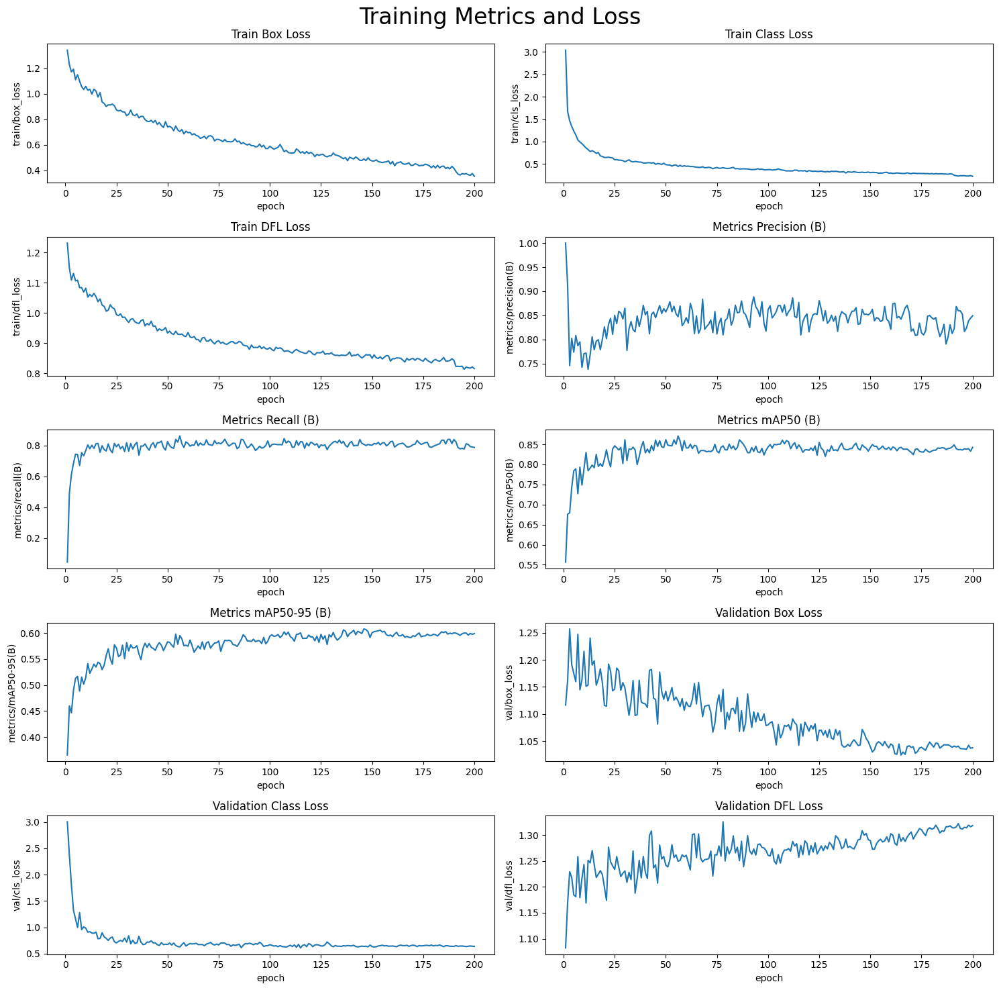

In [22]:
%matplotlib inline
# read in the results.csv file as a pandas dataframe
df = pd.read_csv('/kaggle/working/runs/detect/yolov8n_HelmetDetection/results.csv')
df.columns = df.columns.str.strip()

# create subplots using seaborn
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=df, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=df, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=df, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=df, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=df, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=df, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=df, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=df, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=df, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=df, ax=axs[4,1])

# set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')

# add suptitle and subheader
plt.suptitle('Training Metrics and Loss', fontsize=24)

# adjust top margin to make space for suptitle
plt.subplots_adjust(top=0.8)

# adjust spacing between subplots
plt.tight_layout()

plt.show()

# Evaluation

In [23]:
# Loading the best performing model
model = YOLO('/kaggle/working/runs/detect/yolov8n_HelmetDetection/weights/best.pt')

# Evaluating the model on test dataset
metrics = model.val(conf=0.25, split='test')

Ultralytics 8.3.40 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/input/helmet-detection-v3i/test/labels... 80 images, 0 backgrounds, 0 corrupt: 100%|██████████| 80/80 [00:00<00:00, 326.54it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/helmet-detection-v3i/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.06it/s]


                   all         80        193      0.884      0.856      0.889      0.693
                helmet         40         88      0.856      0.875      0.917       0.79
                    LP         20         20          1          1      0.995      0.875
             no helmet         37         85      0.797      0.694      0.756      0.414
Speed: 0.6ms preprocess, 7.9ms inference, 0.0ms loss, 15.0ms postprocess per image
Results saved to runs/detect/val


In [24]:
print(f"Mean Average Precision @.5:.95 : {metrics.box.map}")    
print(f"Mean Average Precision @ .50   : {metrics.box.map50}") 
print(f"Mean Average Precision @ .70   : {metrics.box.map75}")

Mean Average Precision @.5:.95 : 0.6931914099669901
Mean Average Precision @ .50   : 0.8894607670177946
Mean Average Precision @ .70   : 0.7390861490351246


# Test model


In [25]:
results = model.predict(source=os.path.join(CFG.CUSTOM_DATASET_DIR, 'test', 'images'), save=True)
%matplotlib inline

predicitions = glob.glob(os.path.join(CFG.OUTPUT_DIR, 'runs/detect/predict', '*'))


image 1/80 /kaggle/input/helmet-detection-v3i/test/images/0445_05932_b_jpg.rf.ab4cda766333faf5d9118d6820c499cf.jpg: 640x640 1 LP, 7.9ms
image 2/80 /kaggle/input/helmet-detection-v3i/test/images/0502_05240_b_jpg.rf.a2b24870cec0f1358ce87888f39ae6e3.jpg: 640x640 1 LP, 12.4ms
image 3/80 /kaggle/input/helmet-detection-v3i/test/images/0502_06701_b_jpg.rf.d449e4137d34db82b25e7f992d6309d9.jpg: 640x640 1 LP, 10.1ms
image 4/80 /kaggle/input/helmet-detection-v3i/test/images/0504_06601_b_jpg.rf.3d09ba6734d4bb565071ae7a29ccfbf7.jpg: 640x640 1 LP, 10.1ms
image 5/80 /kaggle/input/helmet-detection-v3i/test/images/0505_04736_b_jpg.rf.d3413122b4254f3770f42e8368d7ec5f.jpg: 640x640 1 LP, 7.8ms
image 6/80 /kaggle/input/helmet-detection-v3i/test/images/0506_06676_b_jpg.rf.28780e918df57c0f83c709fea4d40df7.jpg: 640x640 1 LP, 7.8ms
image 7/80 /kaggle/input/helmet-detection-v3i/test/images/0508_06228_b_jpg.rf.cf5cb78dd3bf25bb297723233113b39d.jpg: 640x640 1 LP, 7.8ms
image 8/80 /kaggle/input/helmet-detection-v3

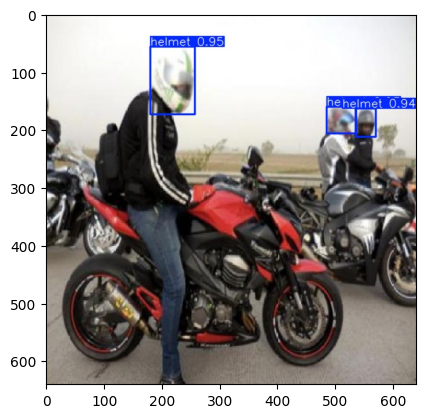

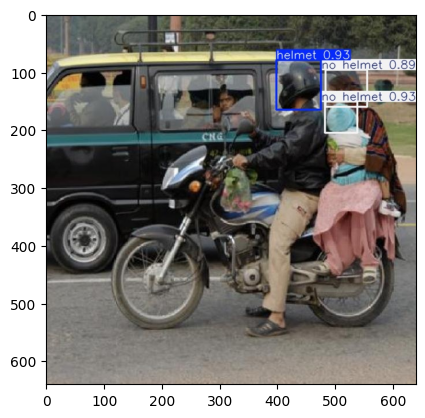

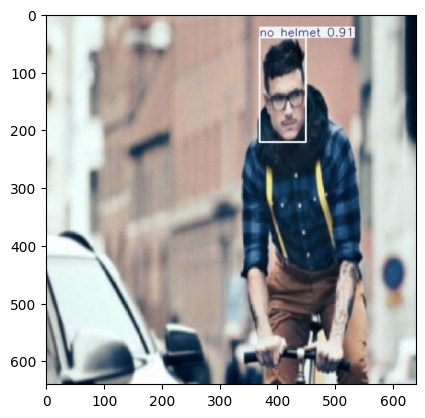

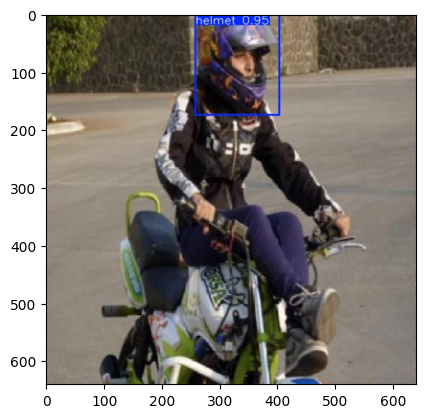

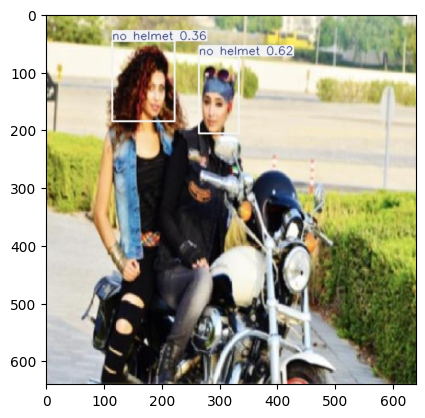

...

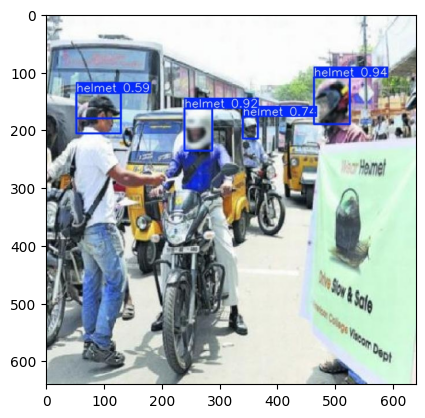

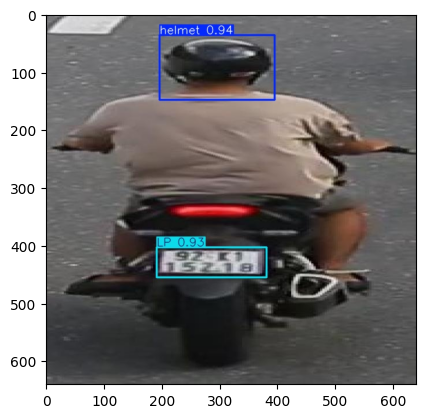

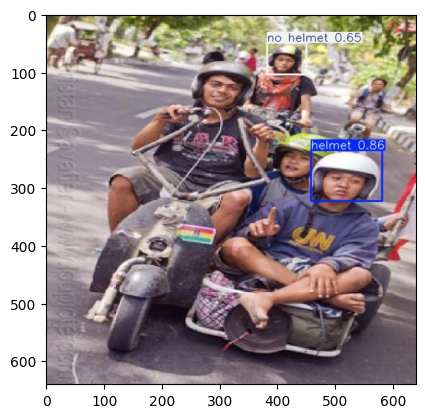

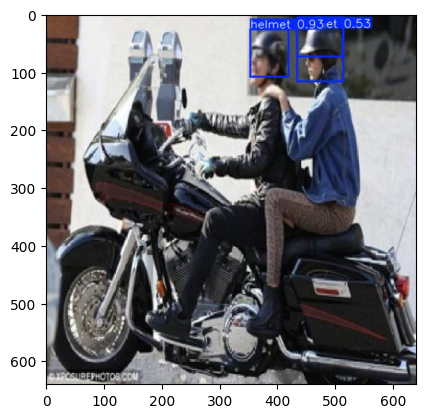

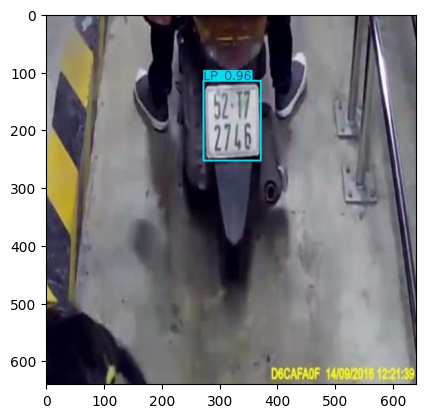

In [26]:


n = 80

for i in range(n):
    idx = np.random.randint(0, len(predicitions))
    image = Image.open(predicitions[idx])
    plt.imshow(image)
    plt.grid(False)
    plt.show()

In [27]:
!zip -r output.zip /kaggle/working/
# !rm -rf /kaggle/working/runs

  adding: kaggle/working/ (stored 0%)
  adding: kaggle/working/runs/ (stored 0%)
  adding: kaggle/working/runs/detect/ (stored 0%)
  adding: kaggle/working/runs/detect/val/ (stored 0%)
  adding: kaggle/working/runs/detect/val/R_curve.png (deflated 14%)
  adding: kaggle/working/runs/detect/val/confusion_matrix.png (deflated 33%)
  adding: kaggle/working/runs/detect/val/val_batch1_labels.jpg (deflated 6%)
  adding: kaggle/working/runs/detect/val/F1_curve.png (deflated 14%)
  adding: kaggle/working/runs/detect/val/val_batch1_pred.jpg (deflated 5%)
  adding: kaggle/working/runs/detect/val/confusion_matrix_normalized.png (deflated 29%)
  adding: kaggle/working/runs/detect/val/val_batch2_pred.jpg (deflated 6%)
  adding: kaggle/working/runs/detect/val/val_batch0_labels.jpg (deflated 8%)
  adding: kaggle/working/runs/detect/val/PR_curve.png (deflated 15%)
  adding: kaggle/working/runs/detect/val/val_batch0_pred.jpg (deflated 8%)
  adding: kaggle/working/runs/detect/val/val_batch2_labels.jpg (d